<p align = "center" draggable=”false” ><img src="https://user-images.githubusercontent.com/37101144/161836199-fdb0219d-0361-4988-bf26-48b0fad160a3.png" 
     width="200px"
     height="auto"/>
</p>

# 🛍️ Launch New Products

Today you are a machine learning engineer at the Department of New Products at Target Cosmetics! 

We will start with a small dataset on interactions between users and current products from the past and try to discover substructure, if there's any, by applying some **unsupervised learning** methods. 

Then we will leverage the small amount of labeled data (current products) in combination with a larger amount of unlabeled data (new products to launch) to make estimations as to which products will sell more. 

## 📚 Learning Objectives

By the end of this session, you will be able to:

- apply dimensionality reduction techniques to reduce features to a lower dimensional space
- perform customer segmentation, determine optional number of clusters, and understand assumptions for used algorithm
- understand what semi-supervised learning is and leverage it to improve performance of supervised learning

## Task 1. Dimensionality Reduction

1. Load in the data. 
    
    Import `pandas` as `pd` and use `pd.read_csv()` to read in `past.csv.gz` in the `dat` folder, saving it as `past`. 
    
    Data in `past.csv.gz` was propcessed; e.g., features indicating time of day, day of week, month, and year of the purchase have been converted to one-hot representations of these categories. 

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

#to scale the data using z-score 
from sklearn.preprocessing import StandardScaler

#importing PCA and TSNE
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE


from matplotlib import style
style.use('dark_background')
past = pd.read_csv('../dat/past.csv.gz')



In [2]:
past.head()

,product_id,user_id,NumOfEventsInJourney,NumSessions,interactionTime,maxPrice,minPrice,NumCart,NumView,NumRemove,...,Dec,Afternoon,Dawn,EarlyMorning,Evening,Morning,Night,Purchased?,Noon,Category
0,5866936,5.618978e+08,1.333333,1.333333,5550.000,15.84000,15.84000,0.00,1.333333,0.00,...,0.00,0.000,0.0,0.666667,0.333333,0.00,0.00,0,0.00,1.0
1,5647110,5.326529e+08,2.250000,1.500000,27556.500,5.80000,5.56500,1.25,0.250000,0.25,...,0.25,0.750,0.0,0.000000,0.250000,0.00,0.00,0,0.00,1.0
2,5790472,4.578109e+08,1.000000,1.000000,0.000,6.27250,6.27250,0.25,0.750000,0.00,...,0.00,0.000,0.0,0.000000,0.750000,0.25,0.00,0,0.00,1.0
3,5811598,4.612641e+08,1.500000,1.500000,131532.500,5.56000,5.56000,0.25,1.000000,0.25,...,0.25,0.000,0.0,0.000000,0.500000,0.00,0.25,0,0.25,1.0
4,5846363,5.157993e+08,1.875000,1.375000,11055.875,4.08625,4.08625,0.50,1.000000,0.25,...,0.25,0.375,0.0,0.125000,0.250000,0.25,0.00,1,0.00,1.0


In [3]:
past.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 37 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   product_id            5000 non-null   int64  
 1   user_id               5000 non-null   float64
 2   NumOfEventsInJourney  5000 non-null   float64
 3   NumSessions           5000 non-null   float64
 4   interactionTime       5000 non-null   float64
 5   maxPrice              5000 non-null   float64
 6   minPrice              5000 non-null   float64
 7   NumCart               5000 non-null   float64
 8   NumView               5000 non-null   float64
 9   NumRemove             5000 non-null   float64
 10  InsessionCart         5000 non-null   float64
 11  InsessionView         5000 non-null   float64
 12  InsessionRemove       5000 non-null   float64
 13  Weekend               5000 non-null   float64
 14  Fr                    5000 non-null   float64
 15  Mon                  

In [4]:
print(past.columns)

Index(['product_id', 'user_id', 'NumOfEventsInJourney', 'NumSessions',
       'interactionTime', 'maxPrice', 'minPrice', 'NumCart', 'NumView',
       'NumRemove', 'InsessionCart', 'InsessionView', 'InsessionRemove',
       'Weekend', 'Fr', 'Mon', 'Sat', 'Sun', 'Thu', 'Tue', 'Wed', '2019',
       '2020', 'Jan', 'Feb', 'Oct', 'Nov', 'Dec', 'Afternoon', 'Dawn',
       'EarlyMorning', 'Evening', 'Morning', 'Night', 'Purchased?', 'Noon',
       'Category'],
      dtype='object')


<details>
<summary> Expected output </summary>

```
Index(['product_id', 'user_id', 'NumOfEventsInJourney', 'NumSessions',
       'interactionTime', 'maxPrice', 'minPrice', 'NumCart', 'NumView',
       'NumRemove', 'InsessionCart', 'InsessionView', 'InsessionRemove',
       'Weekend', 'Fr', 'Mon', 'Sat', 'Sun', 'Thu', 'Tue', 'Wed', '2019',
       '2020', 'Jan', 'Feb', 'Oct', 'Nov', 'Dec', 'Afternoon', 'Dawn',
       'EarlyMorning', 'Evening', 'Morning', 'Night', 'Purchased?', 'Noon',
       'Category'],
      dtype='object')
```
</details>

In [5]:
past.isnull().sum() # checking to make sure there's no null values

product_id              0
user_id                 0
NumOfEventsInJourney    0
NumSessions             0
interactionTime         0
maxPrice                0
minPrice                0
NumCart                 0
NumView                 0
NumRemove               0
InsessionCart           0
InsessionView           0
InsessionRemove         0
Weekend                 0
Fr                      0
Mon                     0
Sat                     0
Sun                     0
Thu                     0
Tue                     0
Wed                     0
2019                    0
2020                    0
Jan                     0
Feb                     0
Oct                     0
Nov                     0
Dec                     0
Afternoon               0
Dawn                    0
EarlyMorning            0
Evening                 0
Morning                 0
Night                   0
Purchased?              0
Noon                    0
Category                0
dtype: int64

2. What percentage of the interactions (rows) resulted in a purchase?

    Do people mostly buy what they look at or do they do a lot of "window shopping" (shopping around without buying)?
    
    From the perspective of classification, is the data balanced?

As we can see from the description below and by checking manually, 34% or 1,719 of interactions resulted in purchase.  From the average number of views (89%), it would appear that many people window shop but don't buy but it is unclear since the total count of views is only 583 of all sessions (it would help to see a data dictionary to better understand how these terms are defined and how exactly they were entered as it's not clear if it's time based, ratio based or what.. we've only been told that it was one hot encoded - which would be zero or 1, not 1.3 or .25 ). 
Would appreciate some feedback on how best to read this given the format. Thanks!

In [6]:
past.describe()

,product_id,user_id,NumOfEventsInJourney,NumSessions,interactionTime,maxPrice,minPrice,NumCart,NumView,NumRemove,...,Dec,Afternoon,Dawn,EarlyMorning,Evening,Morning,Night,Purchased?,Noon,Category
count,5.000000e+03,5.000000e+03,5000.000000,5000.000000,5.000000e+03,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,...,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000
mean,5.573727e+06,5.235286e+08,1.951080,1.327052,2.490234e+05,7.457600,7.426321,0.541953,0.893687,0.413592,...,0.169931,0.213311,0.065900,0.162676,0.244012,0.169207,0.085550,0.343800,0.059343,1.143728
std,1.161840e+06,5.998702e+07,1.324727,0.718266,6.920382e+05,11.883206,11.876266,0.565350,0.841036,0.772170,...,0.255599,0.275556,0.172911,0.246050,0.289270,0.252342,0.191101,0.475023,0.153912,0.438141
min,4.104000e+03,6.524181e+07,1.000000,1.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,5.760491e+06,4.998498e+08,1.000000,1.000000,0.000000e+00,2.483750,2.480000,0.000000,0.500000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
50%,5.830816e+06,5.343735e+08,1.750000,1.166667,3.626375e+03,4.440585,4.440000,0.500000,1.000000,0.222222,...,0.000000,0.142857,0.000000,0.000000,0.181818,0.000000,0.000000,0.000000,0.000000,1.000000
75%,5.875312e+06,5.616843e+08,2.308355,1.500000,2.071993e+05,7.620000,7.550000,0.858766,1.000000,0.632775,...,0.250000,0.333333,0.040000,0.250000,0.363636,0.250000,0.090909,1.000000,0.041888,1.045996
max,5.932538e+06,6.220262e+08,40.000000,28.000000,1.087537e+07,236.510000,236.510000,12.000000,28.000000,38.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,4.000000


In [7]:
past.shape

(5000, 37)

In [13]:
# Look at the distribution of the features to ensure that they are balanced
sns.pairplot(past,hue='Purchased?')


In [8]:
past.groupby(past['Purchased?']==1).count()

,product_id,user_id,NumOfEventsInJourney,NumSessions,interactionTime,maxPrice,minPrice,NumCart,NumView,NumRemove,...,Dec,Afternoon,Dawn,EarlyMorning,Evening,Morning,Night,Purchased?,Noon,Category
Purchased?,,,,,,,,,,,,,,,,,,,,,
False,3281,3281,3281,3281,3281,3281,3281,3281,3281,3281,...,3281,3281,3281,3281,3281,3281,3281,3281,3281,3281
True,1719,1719,1719,1719,1719,1719,1719,1719,1719,1719,...,1719,1719,1719,1719,1719,1719,1719,1719,1719,1719


In [9]:
percentage = 1719/5000 # Percentage of people who purchased = 34%
# This is also reflected above in describe: 

In [10]:
past.groupby(past['NumView']).count()

,product_id,user_id,NumOfEventsInJourney,NumSessions,interactionTime,maxPrice,minPrice,NumCart,NumRemove,InsessionCart,...,Dec,Afternoon,Dawn,EarlyMorning,Evening,Morning,Night,Purchased?,Noon,Category
NumView,,,,,,,,,,,,,,,,,,,,,
0.000000,583,583,583,583,583,583,583,583,583,583,...,583,583,583,583,583,583,583,583,583,583
0.083333,3,3,3,3,3,3,3,3,3,3,...,3,3,3,3,3,3,3,3,3,3
0.100000,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
0.111111,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
0.125000,2,2,2,2,2,2,2,2,2,2,...,2,2,2,2,2,2,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9.000000,2,2,2,2,2,2,2,2,2,2,...,2,2,2,2,2,2,2,2,2,2
10.200000,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
16.000000,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1


In [11]:
583/5000  # if going by the count of NumViews, only 12% of total sesions were viewed. I'll try to 
# see if there is a way to visualize the percentage of categories for numview...

0.1166

product_id
Skew : -4.55


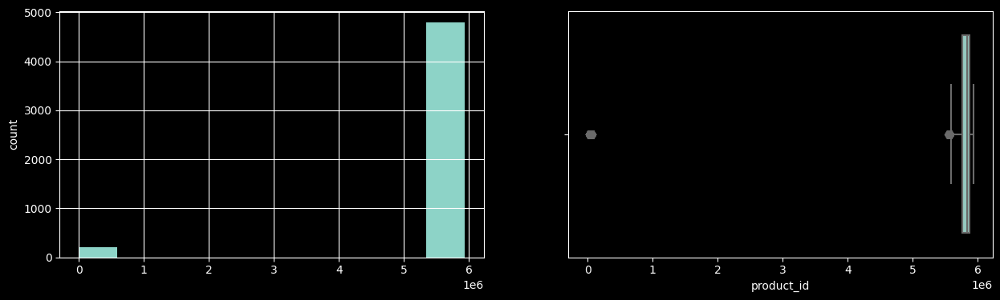

user_id
Skew : -1.88


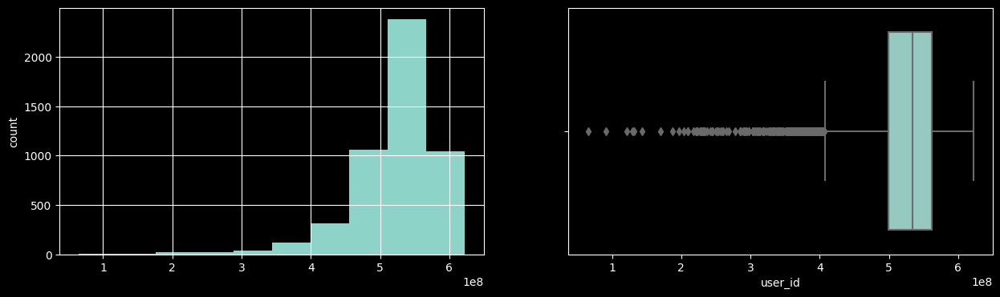

NumOfEventsInJourney
Skew : 9.75


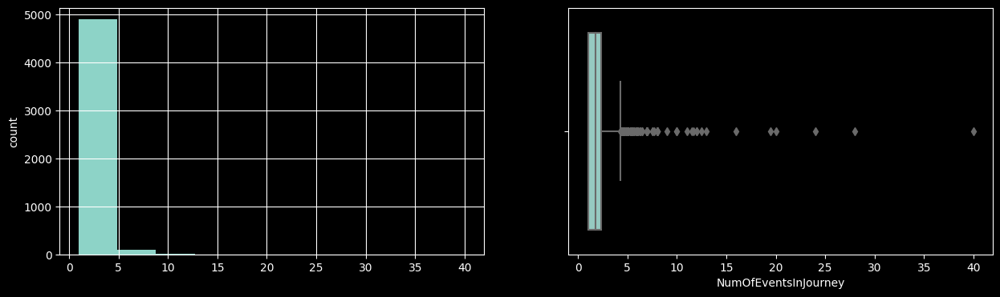

NumSessions
Skew : 18.37


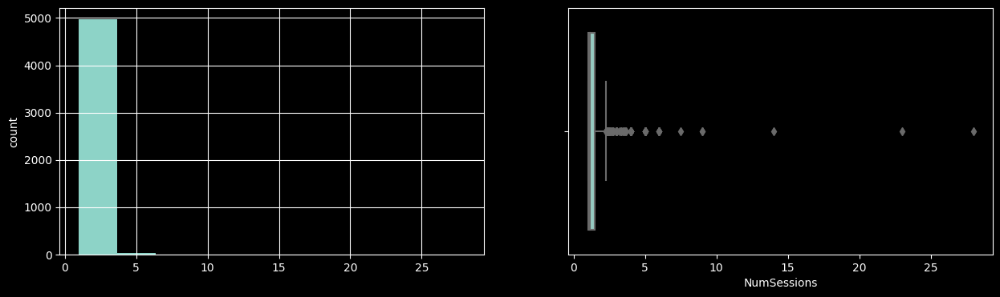

interactionTime
Skew : 6.68


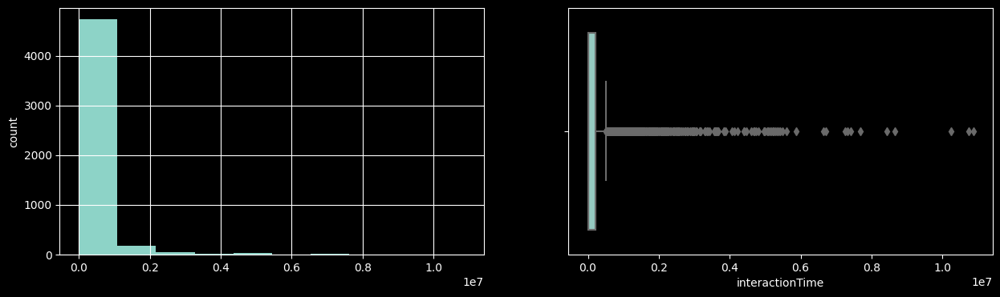

maxPrice
Skew : 7.11


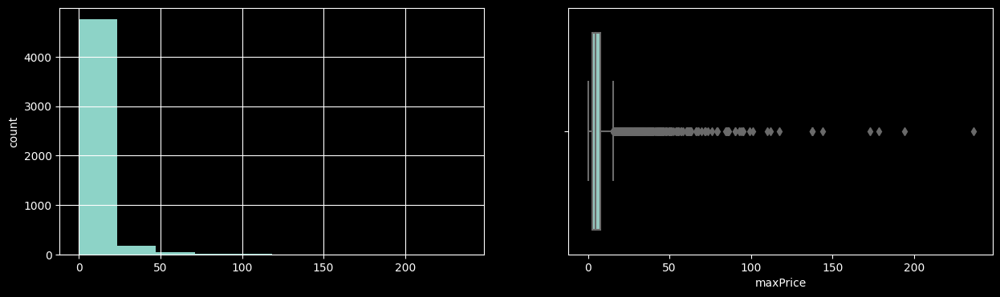

minPrice
Skew : 7.12


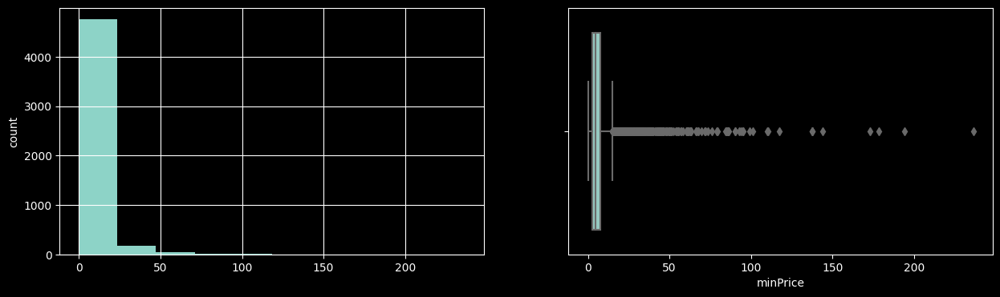

NumCart
Skew : 3.6


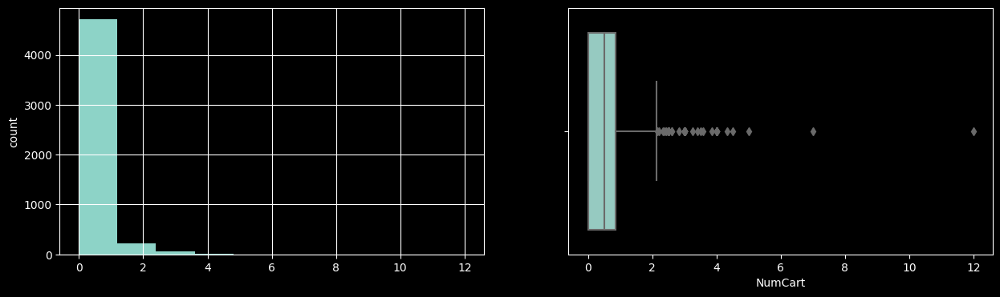

NumView
Skew : 13.39


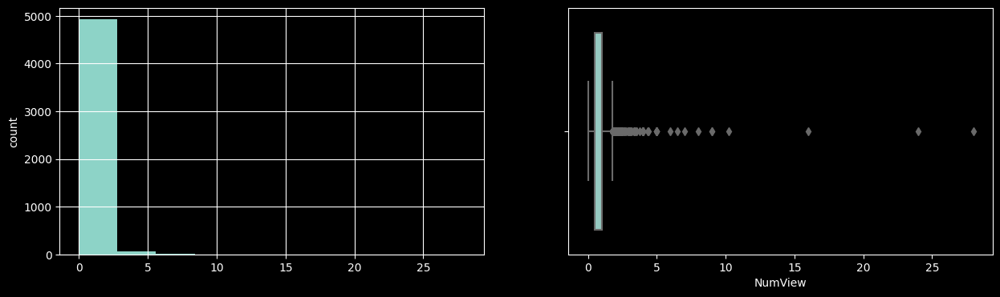

NumRemove
Skew : 24.02


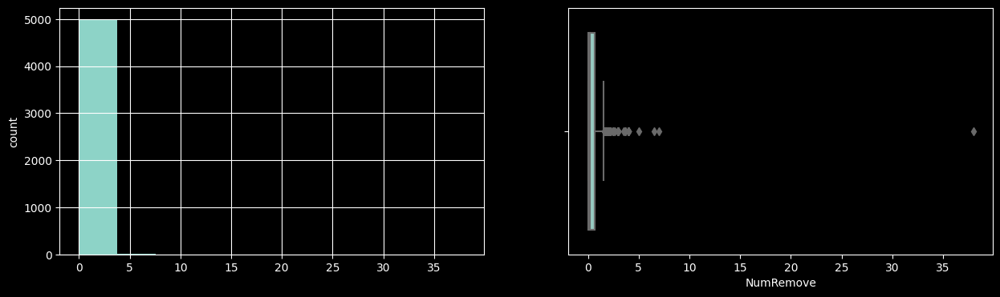

InsessionCart
Skew : 14.3


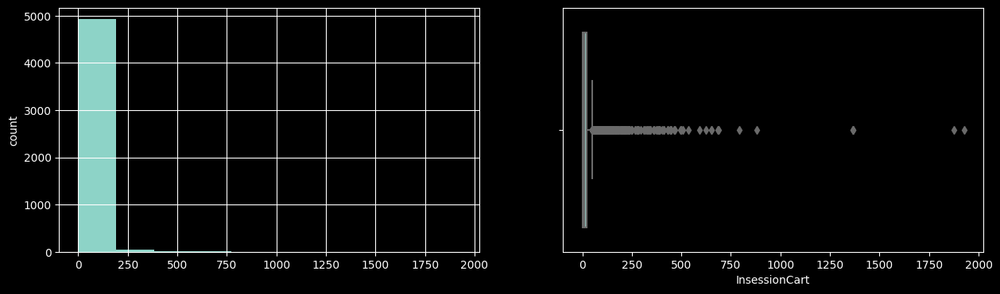

InsessionView
Skew : 23.71


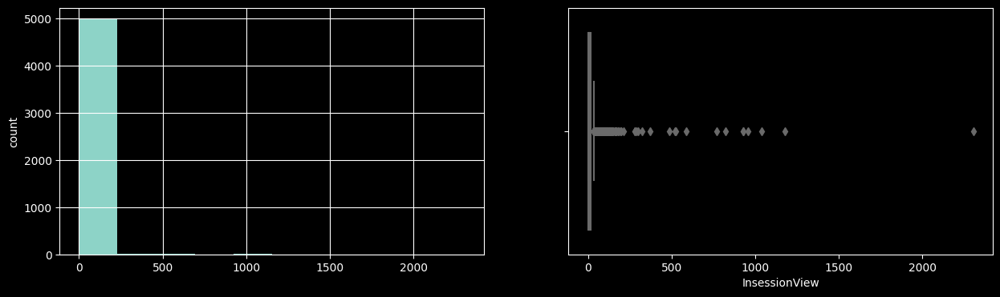

InsessionRemove
Skew : 12.85


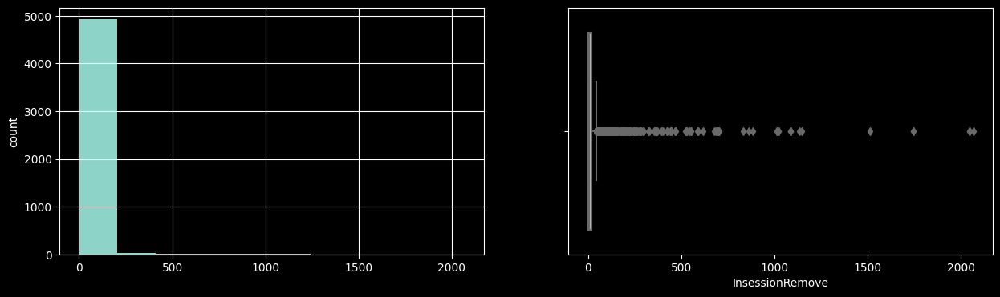

Weekend
Skew : 0


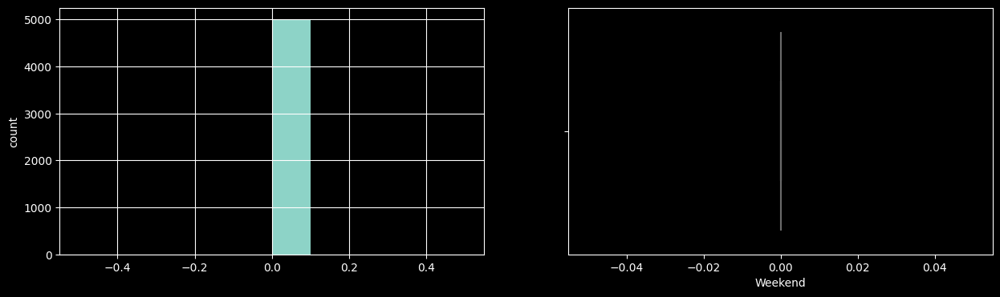

Fr
Skew : 2.31


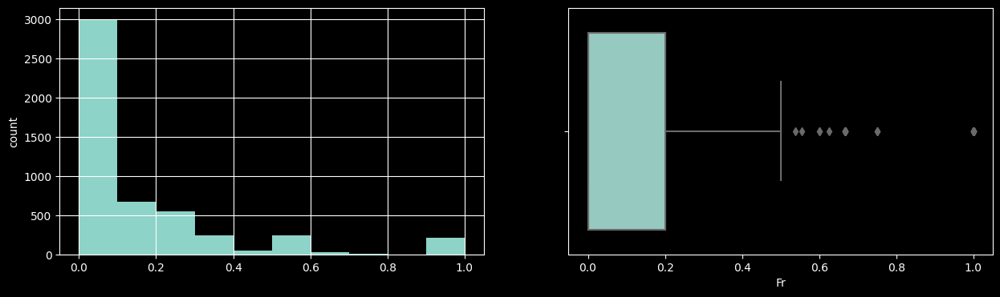

Mon
Skew : 2.21


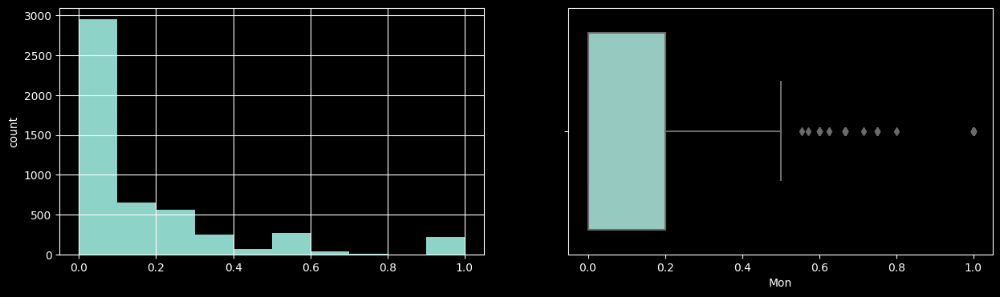

Sat
Skew : 2.41


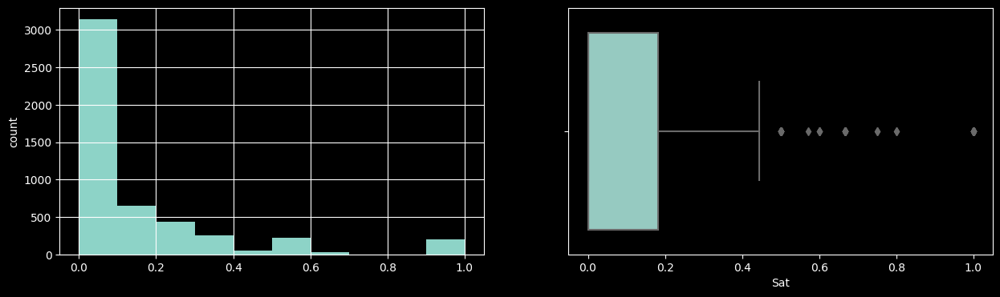

Sun
Skew : 2.41


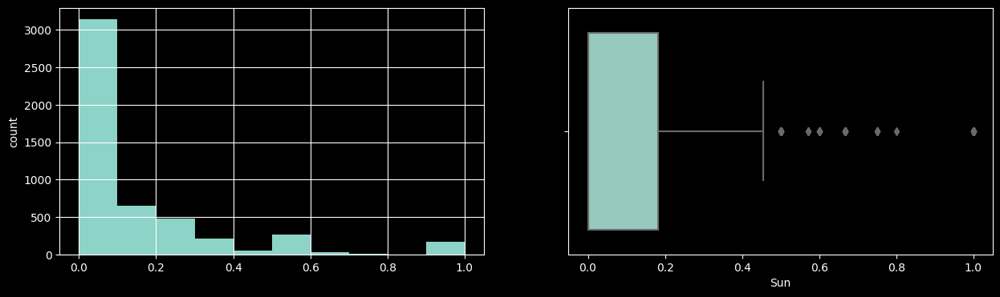

Thu
Skew : 2.15


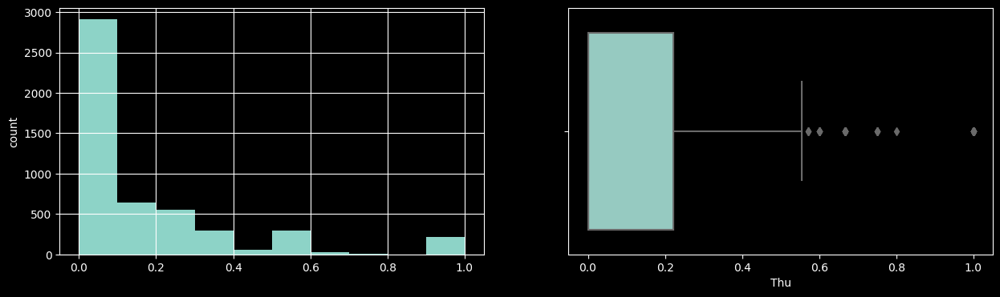

Tue
Skew : 2.13


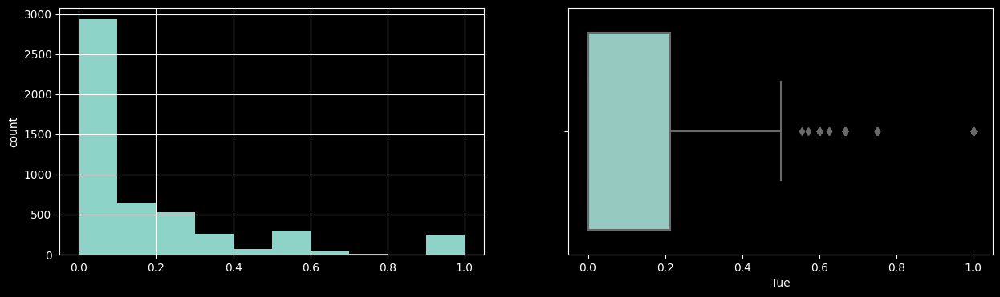

Wed
Skew : 2.13


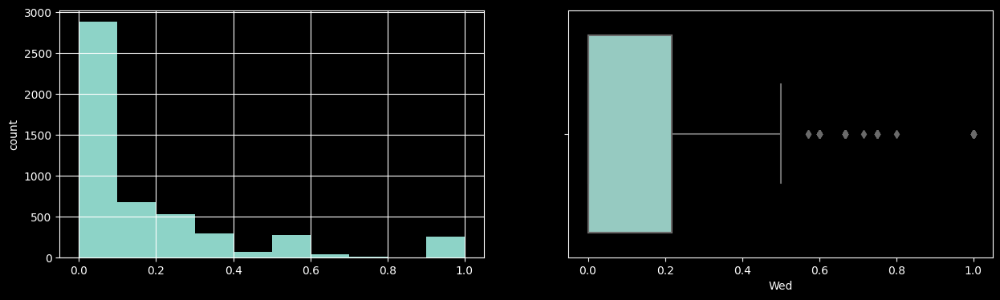

2019
Skew : -0.33


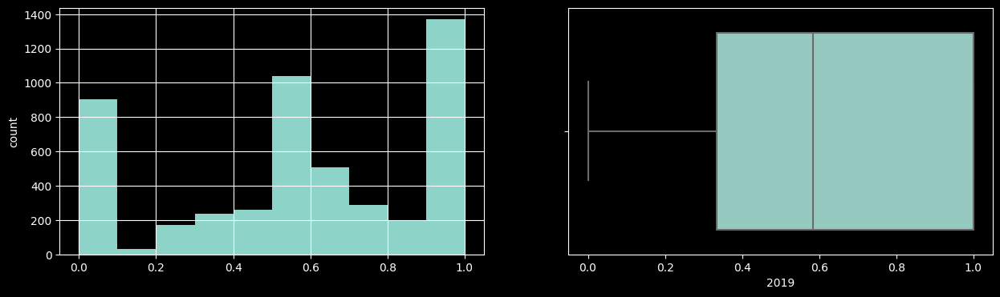

2020
Skew : 0.33


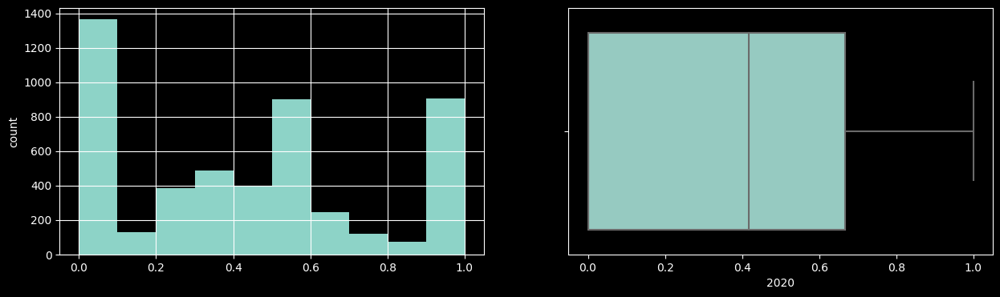

Jan
Skew : 1.59


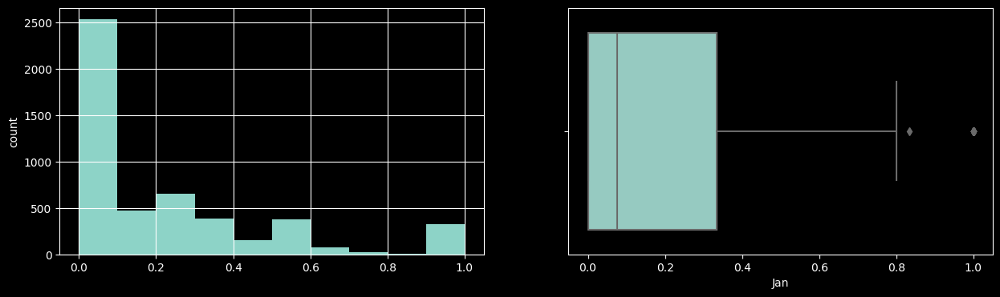

Feb
Skew : 1.44


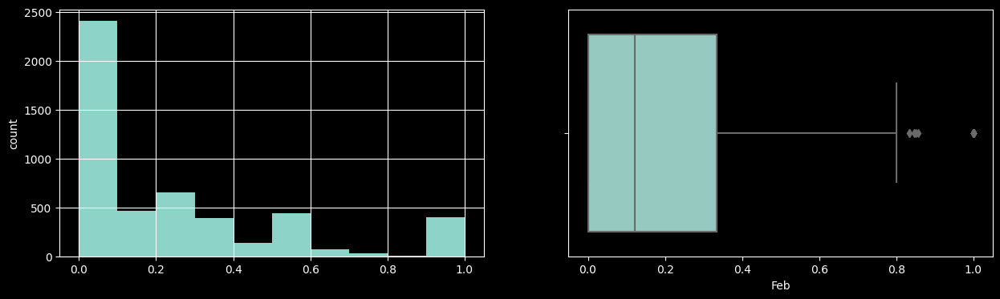

Oct
Skew : 1.64


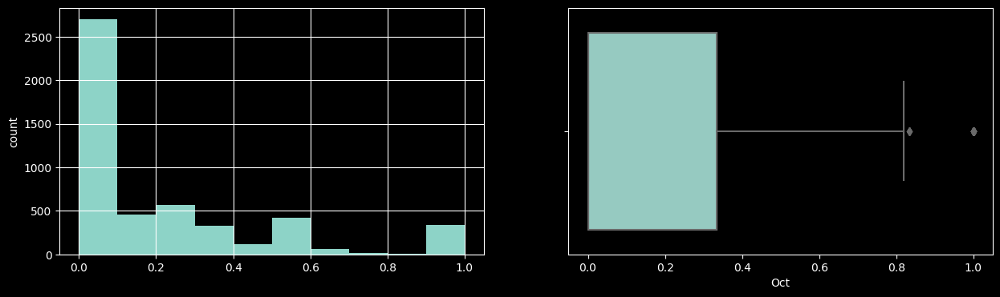

Nov
Skew : 1.53


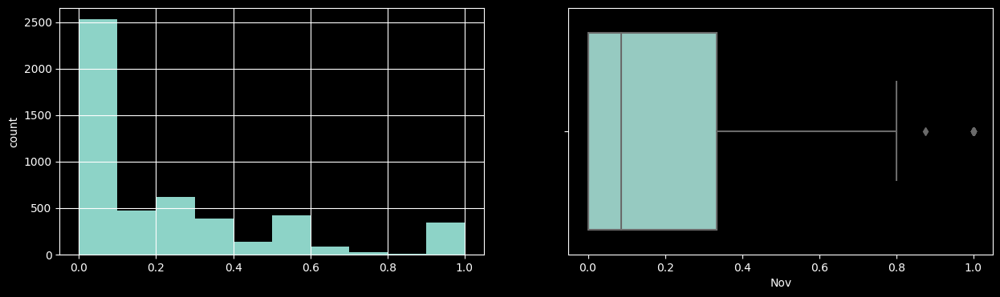

Dec
Skew : 1.87


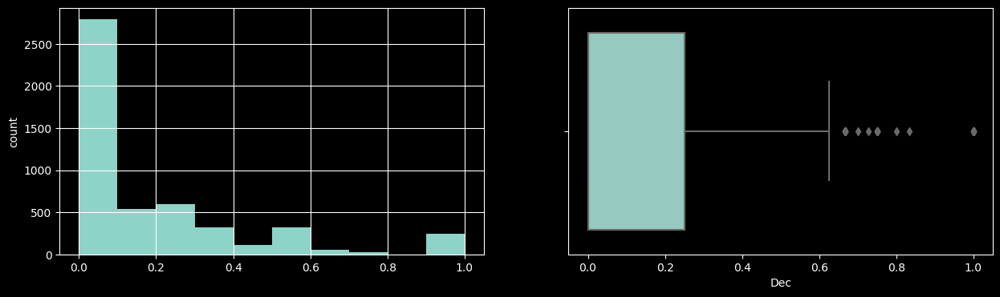

Afternoon
Skew : 1.53


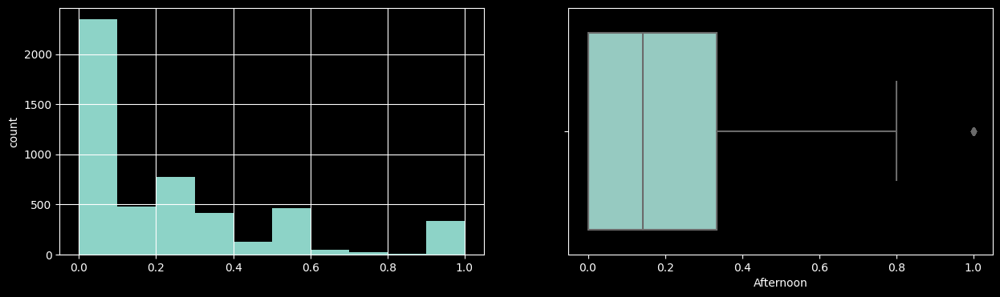

Dawn
Skew : 3.86


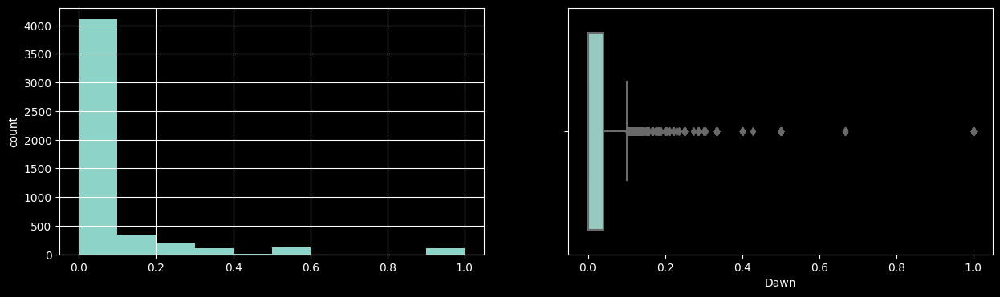

EarlyMorning
Skew : 1.98


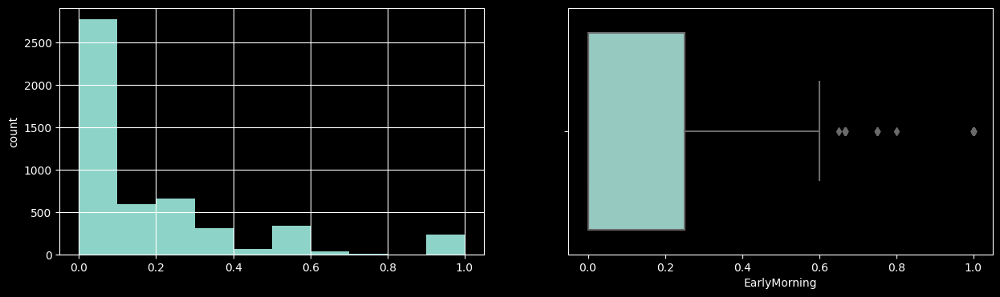

Evening
Skew : 1.29


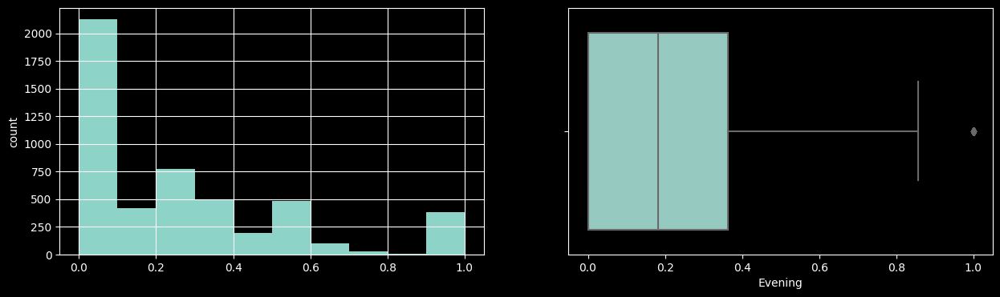

Morning
Skew : 1.93


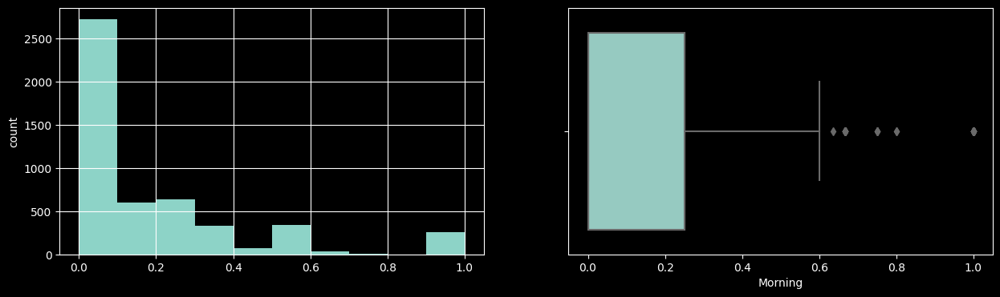

Night
Skew : 3.28


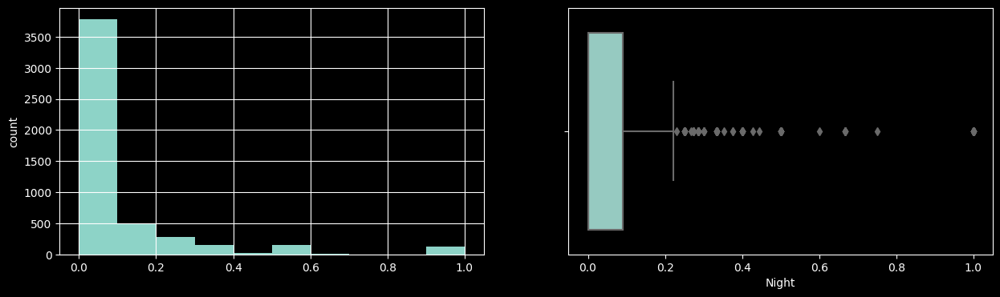

Purchased?
Skew : 0.66


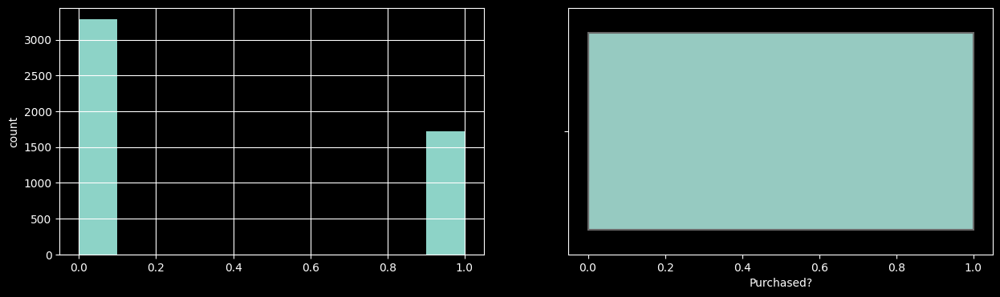

Noon
Skew : 4.11


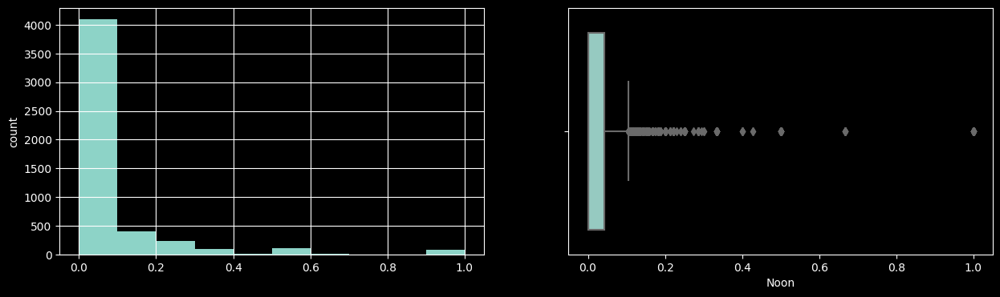

Category
Skew : 3.81


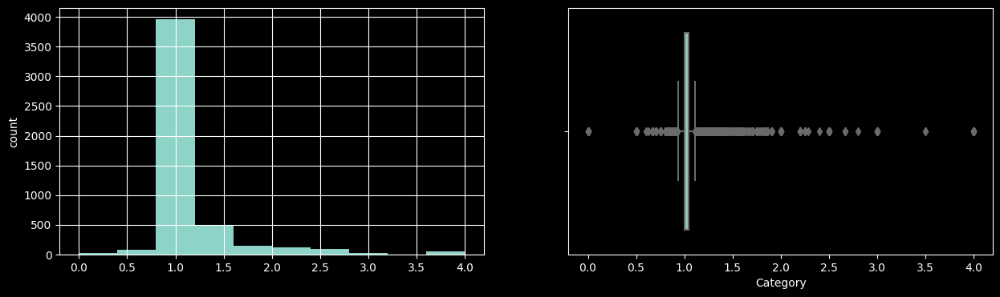

In [12]:
for col in past.columns:
     print(col)
     print('Skew :',round(past[col].skew(),2))
     plt.figure(figsize=(15,4))
     plt.subplot(1,2,1)
     past[col].hist()
     plt.ylabel('count')
     plt.subplot(1,2,2)
     sns.boxplot(x= past[col])
     plt.show()

From the above, we can see weekend counts tend to be right skewed 

In [13]:
import seaborn as sns
def bar_perc(plot, feature):
    total = len(feature) # length of the column
    for p in ax.patches:
        percentage= '{:.1f}%'.format(100 * p.get_height()/total) #percentage of each class of the category
        width = p.get_width() /2 - 0.05 #width of plot
        x = p.get_x() + width 
        height = p.get_height() #height of the plot
        y = p.get_y() + height
        ax.annotate(percentage, (x,y), size = 12) # annotate the percentage


/home/skfl/anaconda3/envs/mlops-course/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


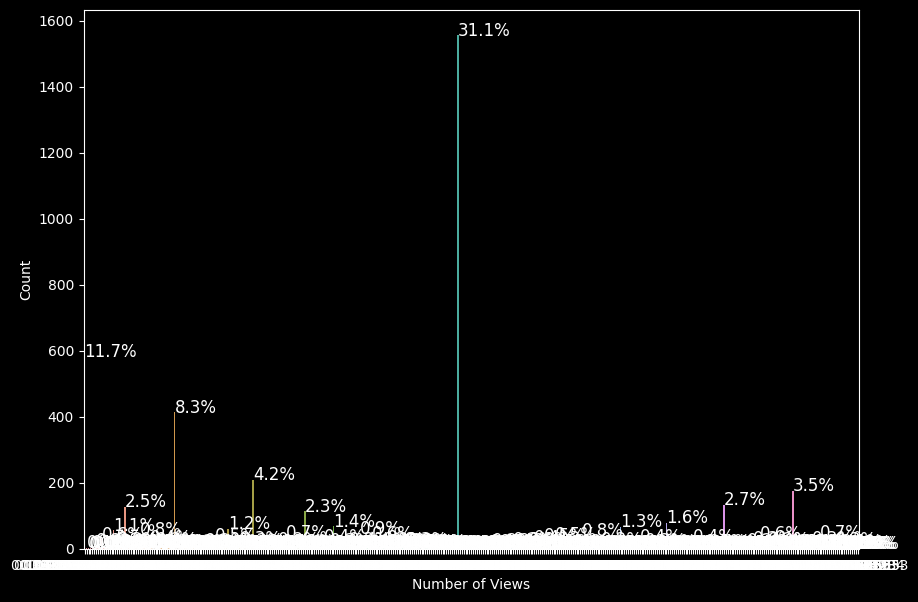

In [14]:
plt.figure(figsize=(10,7))
ax = sns.countplot(past['NumView'])
plt.xlabel('Number of Views')
plt.ylabel('Count')
bar_perc(ax,past['NumView'])
# sadly, since there are so many views, this only tells us that one particular product represented 
# the greatest number of views... 

3. Drop `product_id` and `user_id` and save the rest columns to a new `pd.DataFrame`:`X`; then pop the column `'Purchased?'` and save it to `y`.

In [15]:
X= past.drop(columns=['product_id','user_id'],axis=1)
y = X.pop('Purchased?') 
                

In [16]:
X.head()

,NumOfEventsInJourney,NumSessions,interactionTime,maxPrice,minPrice,NumCart,NumView,NumRemove,InsessionCart,InsessionView,...,Nov,Dec,Afternoon,Dawn,EarlyMorning,Evening,Morning,Night,Noon,Category
0,1.333333,1.333333,5550.000,15.84000,15.84000,0.00,1.333333,0.00,0.000,1.000,...,0.00,0.00,0.000,0.0,0.666667,0.333333,0.00,0.00,0.00,1.0
1,2.250000,1.500000,27556.500,5.80000,5.56500,1.25,0.250000,0.25,3.750,2.250,...,0.25,0.25,0.750,0.0,0.000000,0.250000,0.00,0.00,0.00,1.0
2,1.000000,1.000000,0.000,6.27250,6.27250,0.25,0.750000,0.00,17.250,30.000,...,0.25,0.00,0.000,0.0,0.000000,0.750000,0.25,0.00,0.00,1.0
3,1.500000,1.500000,131532.500,5.56000,5.56000,0.25,1.000000,0.25,3.250,10.500,...,0.25,0.25,0.000,0.0,0.000000,0.500000,0.00,0.25,0.25,1.0
4,1.875000,1.375000,11055.875,4.08625,4.08625,0.50,1.000000,0.25,4.875,3.375,...,0.25,0.25,0.375,0.0,0.125000,0.250000,0.25,0.00,0.00,1.0


In [17]:
assert X.shape == (5000, 34)
assert y.shape == (5000,)

4. Apply [PCA (check documentation if unfamiliar)](https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html) to reduce the number of features down to **5**, save it to a numpy array named `X_reduced`. 

    Do you need to preprocess the data before performing PCA? Quick review [here: Importance of feature scaling](https://scikit-learn.org/stable/auto_examples/preprocessing/plot_scaling_importance.html).
    
    If time permits, read [Does mean centering or feature scaling affect a Principal Component Analysis?](https://sebastianraschka.com/faq/docs/pca-scaling.html) or [discussion 1](https://stats.stackexchange.com/questions/53/pca-on-correlation-or-covariance).

In [18]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_reduced = pd.DataFrame(scaler.fit_transform(X), columns=X.columns)
X_reduced.head()


,NumOfEventsInJourney,NumSessions,interactionTime,maxPrice,minPrice,NumCart,NumView,NumRemove,InsessionCart,InsessionView,...,Nov,Dec,Afternoon,Dawn,EarlyMorning,Evening,Morning,Night,Noon,Category
0,-0.466366,0.008746,-0.351856,0.705469,0.708516,-0.958711,0.522796,-0.535676,-0.325080,-0.268297,...,-0.735079,-0.664901,-0.774188,-0.381162,2.048532,0.308813,-0.670613,-0.447714,-0.385606,-0.328074
1,0.225669,0.240810,-0.320053,-0.139505,-0.156742,1.252531,-0.765426,-0.211881,-0.272102,-0.245195,...,0.147418,0.313293,1.947849,-0.381162,-0.661216,0.020702,-0.670613,-0.447714,-0.385606,-0.328074
2,-0.718016,-0.455381,-0.359877,-0.099739,-0.097163,-0.516462,-0.170862,-0.535676,-0.081378,0.267657,...,0.147418,-0.664901,-0.774188,-0.381162,-0.661216,1.749366,0.320204,-0.447714,-0.385606,-0.328074
3,-0.340542,0.240810,-0.169792,-0.159704,-0.157163,-0.516462,0.126420,-0.211881,-0.279165,-0.092725,...,0.147418,0.313293,-0.774188,-0.381162,-0.661216,0.885034,-0.670613,0.860628,1.238862,-0.328074
4,-0.057436,0.066762,-0.343899,-0.283736,-0.281267,-0.074214,0.126420,-0.211881,-0.256208,-0.224404,...,0.147418,0.313293,0.586831,-0.381162,-0.153139,0.020702,0.320204,-0.447714,-0.385606,-0.328074


Determine if features are balanced now that they are scaled. Given that the mean and standard deviation are close to zero and one, respectively, for all features, the features are likely balanced. 

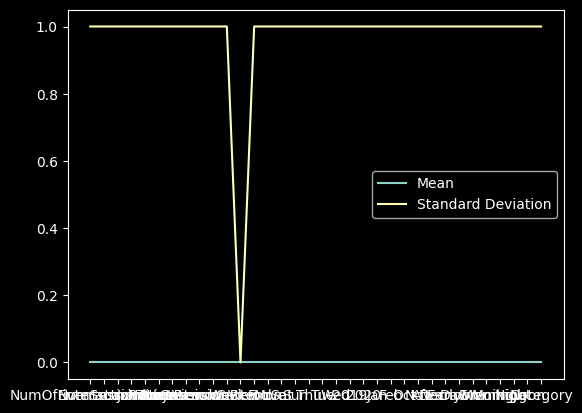

In [19]:
# Calculate the mean and standard deviation of each feature
mean_vec = X_reduced.mean(axis=0)
std_vec = X_reduced.std(axis=0)

# Plot the mean and standard deviation of each feature
plt.plot(mean_vec, label='Mean')
plt.plot(std_vec, label='Standard Deviation')
plt.legend()
plt.show()


In [20]:
# Defining the number of principal components to generate
 
n = X_reduced.shape[1]

#Finding principal components for the data

pca = PCA(n_components=n, random_state= 42) #Applying the PCA algorithm with random state = 2
X_pca1 = pca.fit_transform(X_reduced) #Fitting and transforming the pca function on scaled data


5. Print out the percentage of variance explained by each of the selected components.

In [21]:
pca.explained_variance_ratio_

array([1.02824048e-01, 9.44599910e-02, 6.51818478e-02, 5.15026579e-02,
       4.32085691e-02, 4.07719336e-02, 3.97581589e-02, 3.95511348e-02,
       3.83254842e-02, 3.75242093e-02, 3.69746751e-02, 3.57199625e-02,
       3.50879804e-02, 3.44668188e-02, 3.35628095e-02, 3.31036641e-02,
       3.25341524e-02, 3.19010124e-02, 3.12086356e-02, 3.04720838e-02,
       2.96773620e-02, 2.77130115e-02, 2.05212821e-02, 1.74280657e-02,
       9.55244736e-03, 6.63769737e-03, 3.19398767e-04, 1.09063702e-05,
       2.02784678e-32, 8.90159439e-33, 5.95760448e-33, 3.46185416e-33,
       2.76944535e-33, 5.31632889e-34])

In [22]:
#The percentage of variance explained by each principal component
exp_var = pca.explained_variance_ratio_


In [23]:
exp_var.shape

(34,)

Text(0, 0.5, 'Cumulative Explained Variance')

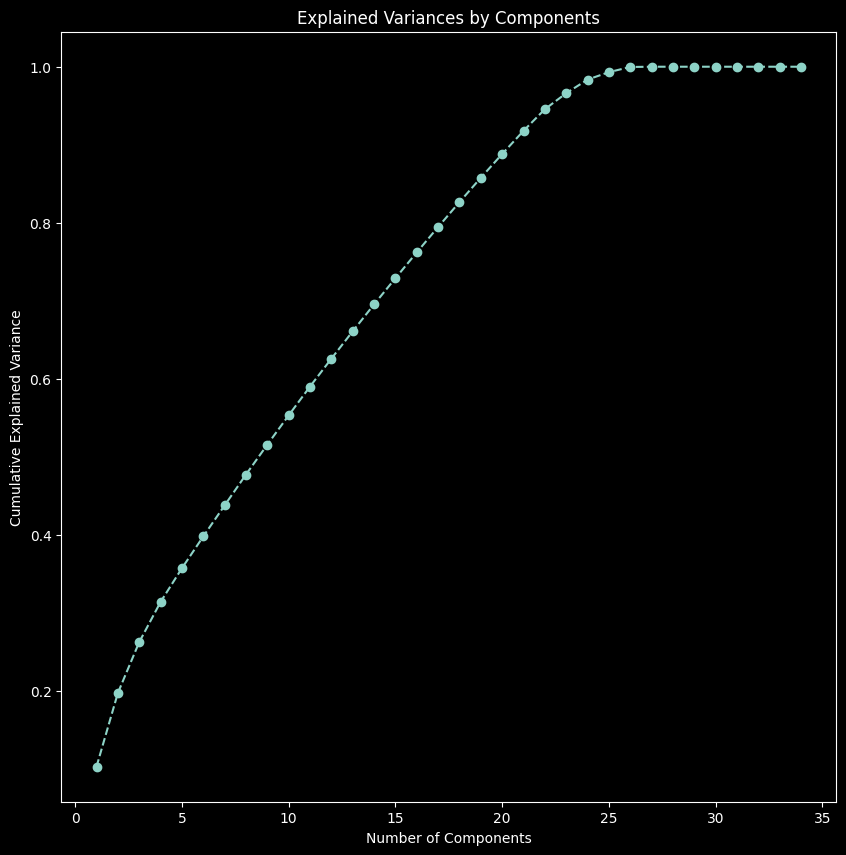

In [31]:
# visualizing the explained variance by individual components
plt.figure(figsize = (10,10))
plt.plot(range(1,35), exp_var.cumsum(), marker = 'o', linestyle = '--')
plt.title("Explained Variances by Components")
plt.xlabel("Number of Components")
plt.ylabel("Cumulative Explained Variance")

In [24]:
#The above seems to indicate our we would need almost all of our components (20) to explain variation, which is too much, 
# so I'll try seeing if using covarian matrix and eigenvalues makes a difference.
# visualizing the explained variance by individual components
import numpy as np
cov_mat = np.cov(X_reduced.T)
eigen_vals, eigen_vecs = np.linalg.eig(cov_mat)
print('\nEigenvalues \n',eigen_vals)


Eigenvalues 
 [ 3.39387235e+00  3.11780326e+00  2.15143126e+00  2.19087831e-01
  1.05422678e-02  3.59982212e-04  3.15293822e-01  1.69992770e+00
  5.75241216e-01  6.77337778e-01  1.42616801e+00  9.14712321e-01
  1.34574296e+00  1.31228170e+00  1.30544854e+00  1.26499398e+00
  9.79548857e-01  1.23854662e+00  1.22040836e+00  1.00577992e+00
  1.03009099e+00  1.17899456e+00  1.15813498e+00  1.13763255e+00
  1.05294400e+00  1.10779427e+00  1.09263944e+00  1.07384180e+00
  1.26679109e-15 -8.73922805e-16 -5.96371084e-16 -2.34954666e-17
 -2.64259280e-16  0.00000000e+00]


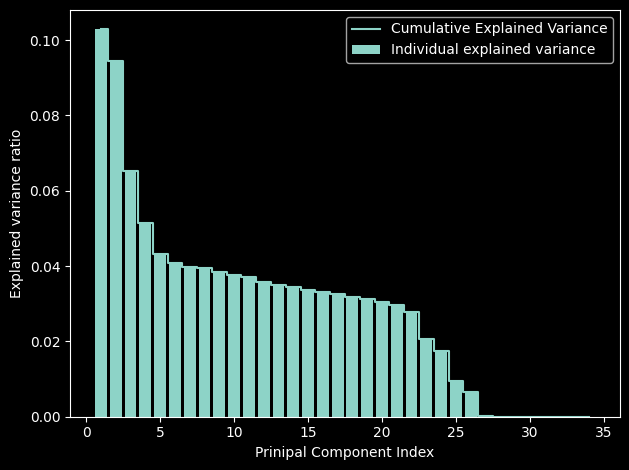

In [25]:
#Show total and explained variance to determine relative importance of principal components
tot = sum(eigen_vals)
var_exp = [(i /tot) 
           for i in sorted(eigen_vals, reverse=True)]
cum_var_exp = np.cumsum(var_exp)
plt.bar(range(1,35),var_exp, align='center',
        label='Individual explained variance')
plt.step(range(1,35),var_exp, where='mid',
         label='Cumulative Explained Variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Prinipal Component Index')
plt.legend (loc = 'best')
plt.tight_layout()
plt.show()

The above visual provides a close up illustrating that the fist component explains most of the variance (12%) and that the first three components represent the majority of the cumulative explained variance.Therefore, we should only need one or two principal components for our analysis. Ideally, we would want more of the variance explained but the first two would suffice. I'll continue with 3 given assignment.

In [26]:
pc_comps = ['PC1','PC2','PC3']
X_pca = pd.DataFrame(np.round(pca.components_[:3,:],2),index=pc_comps,columns=X_reduced.columns)
X_pca.T

,PC1,PC2,PC3
NumOfEventsInJourney,0.21,0.45,0.17
NumSessions,0.20,0.37,0.28
interactionTime,0.19,0.26,0.08
maxPrice,-0.03,-0.19,0.52
minPrice,-0.03,-0.19,0.52
NumCart,0.13,0.32,-0.12
NumView,0.12,0.18,0.42
NumRemove,0.13,0.31,-0.08
InsessionCart,0.10,0.11,-0.26
InsessionView,0.03,0.05,-0.09


6. Review code in functions `visualize_2pcs` and `visualize_3pcs` below and visualize first few principal components in 2D and 3D plots, respectively:

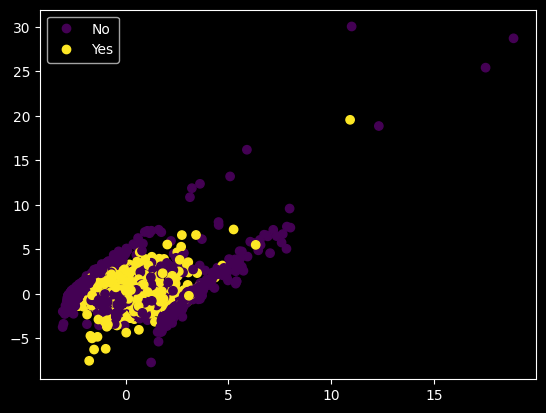

In [34]:
import matplotlib.pyplot as plt


def visualize_2pcs(X_pca1, y):
    fig, ax = plt.subplots()
    plot = plt.scatter(X_pca1[:,0], X_pca1[:,1], c=y) 
    ax.legend(
        handles=plot.legend_elements()[0], 
        labels=['No', 'Yes'])
    plt.show()

visualize_2pcs(X_pca1,y) 

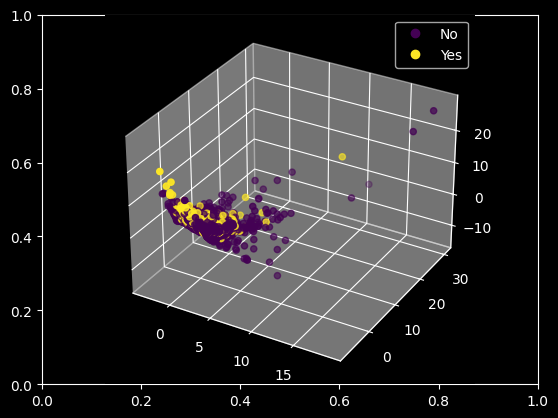

In [35]:
def visualize_3pcs(X_pca1, y):
    fig, ax = plt.subplots()
    ax = fig.add_subplot(projection='3d')
    plot = ax.scatter(X_pca1[:,0], X_pca1[:,1], X_pca1[:,2], c=y)
    ax.legend(
        handles=plot.legend_elements()[0], 
        labels=['No', 'Yes'])
    plt.show()
    
visualize_3pcs(X_pca1,y)

In [34]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D


def visualize_3pcs(X_pca1, y):
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    plot = ax.scatter(X_pca1[:,0], X_pca1[:,1], X_pca1[:,2], c=y)
    ax.legend(
        handles=plot.legend_handles, 
        labels=['No', 'Yes'])
    ax.set_xlabel('First Principal Component')
    ax.set_ylabel('Second Principal Component')
    ax.set_zlabel('Third Principal Component')
    plt.show()
    



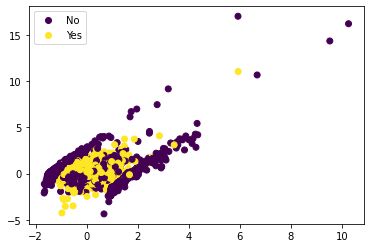

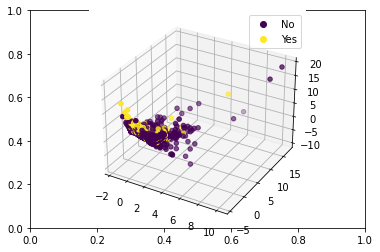

In [ ]:
# Call the function and pass in the required data
visualize_3pcs(X_pca, y)


7. One way to assess the quality of the dimensionality reduction, when the groundtruth is available of course, is comparing the prediction performance using given features vs reduced (engineered) features.

    Complete the wrapper function below that 

    - takes features, target, and a boolean parameter indicating whether to include standardization in the pipeline or not
    - split the data into train (80%) and test (20%) datasets, set the random state for spliting at 0
    - build a pipeline that 

        1) preprocessing data using standardization if the `standardize` is `True`; otherwise skip this step  

        2) apply logistic regression ( are the labels balanced? )
        
    - fit the pipeline using training data
    - print the classification report (use `sklearn.metrics.classification_report`) on test data

In [ ]:
# YOUR CODE HERE (imports!)

def train(X, y, standardize = True) -> None:
    # YOUR CODE HERE

Now apply the pipeline on the all the features `X` and review the performance

In [ ]:
# YOUR CODE HERE

              precision    recall  f1-score   support

           0       0.75      0.77      0.76       649
           1       0.55      0.52      0.54       351

    accuracy                           0.68      1000
   macro avg       0.65      0.65      0.65      1000
weighted avg       0.68      0.68      0.68      1000



Similarly, apply the pipeline on the reduced / engineered features `X_reduced`. Should you include standardization in the pipeline?

In [ ]:
# YOUR CODE HERE

              precision    recall  f1-score   support

           0       0.74      0.70      0.72       649
           1       0.49      0.54      0.51       351

    accuracy                           0.64      1000
   macro avg       0.61      0.62      0.62      1000
weighted avg       0.65      0.64      0.65      1000



8. Are the results as expected? Discuss the pros and cons using reduced set of features in this application with your teammate. 
    *YOUR ANSWER HERE*

## Task 2. Customer Segmentation

In this task, we apply k-means clustering on the reduced data, experimenting different vaules of `n_cluster`, summarize all this information in a single plot, the *Elbow* plot. In addition, leverage silhouette visualization to help decide the "optimal" number of clusters in our data and answer: 

1. Are there any patterns among customer purchasing behaviors?
2. If so, what categories do they belong to? How do you characterize the clusters?
3. If not, what followup steps and / or recommendations will you make as an MLE?

1. Look up the [documentation](https://scikit-learn.org/stable/modules/clustering.html) and import the model class for k-means from `sklearn.cluster`

In [ ]:
# YOUR CODE HERE

2. Complete `visualize_elbow`; inspect the code and complete

    - fit k-means on the given data `X` and `k`, setting `random_state` to be 10 for reproducibility
    - append the sum of squared distances of samples to their closest cluster center for each $k$ to list `inertias`

In [ ]:
def visualize_elbow(X, ks):
    fig, ax = plt.subplots()
    inertias = []
    for k in ks:
        # YOUR CODE HERE
        # YOUR CODE HERE
    plt.plot(ks, inertias)
    plt.xticks(ks)
    plt.xlabel('Number of clusters')
    plt.ylabel('Inertia')
    plt.title('Elbow plot')

3. Visualize the elbow plot for the number of clusters ranging between 2 and 9. Discuss with your teammate, what is the 'optimal' number of clusters?

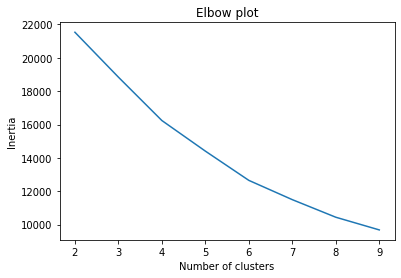

In [ ]:
# YOUR CODE HERE

4. What are the disadvantage to use the Elbow method? 

    *YOUR ANSWER HERE*

5. Let's try a different approach: [silhouette score](https://towardsdatascience.com/clustering-metrics-better-than-the-elbow-method-6926e1f723a6).

    A helper function `visualize_silhouette` is provided for you (inspect the code in `utils.py`) and figure out how to use it to visualize k-means for k ranges from 2 to 8 on the reduced data. 

In [ ]:
from utils import visualize_silhouette

For n_clusters = 2 The average silhouette_score is : 0.19919967382453047
For n_clusters = 3 The average silhouette_score is : 0.21238428422148908
For n_clusters = 4 The average silhouette_score is : 0.21846259845030108
For n_clusters = 5 The average silhouette_score is : 0.2055016602111605
For n_clusters = 6 The average silhouette_score is : 0.20861307391519884
For n_clusters = 7 The average silhouette_score is : 0.2137422138377995
For n_clusters = 8 The average silhouette_score is : 0.21817268912132334


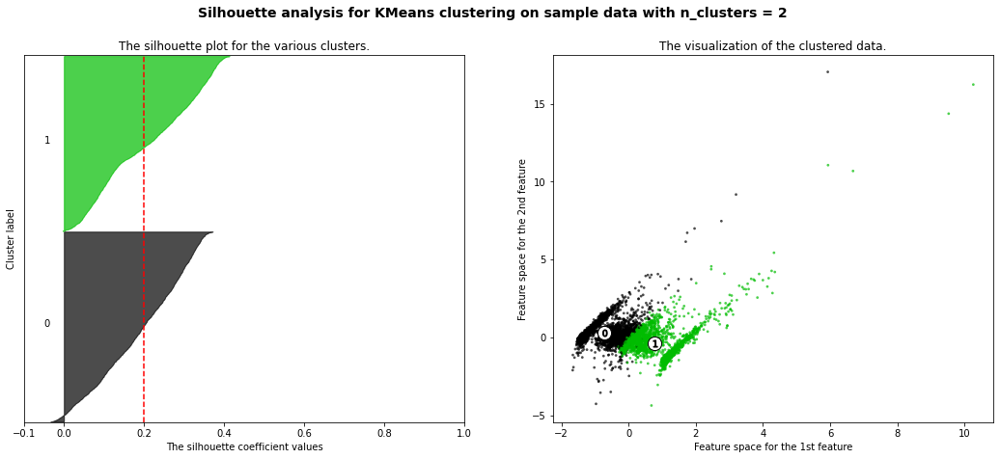

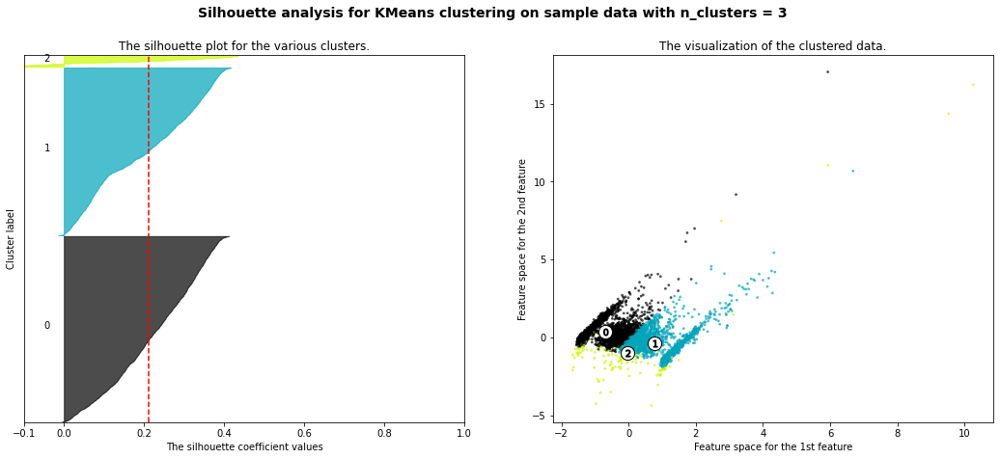

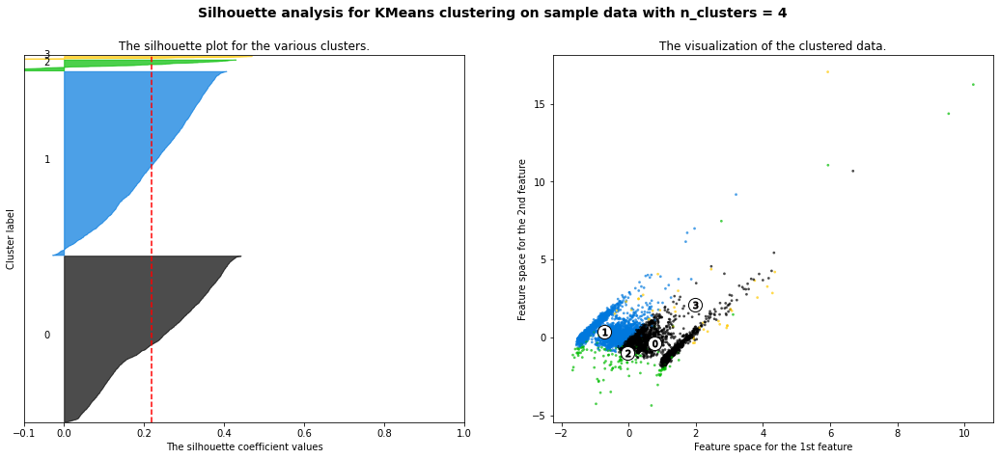

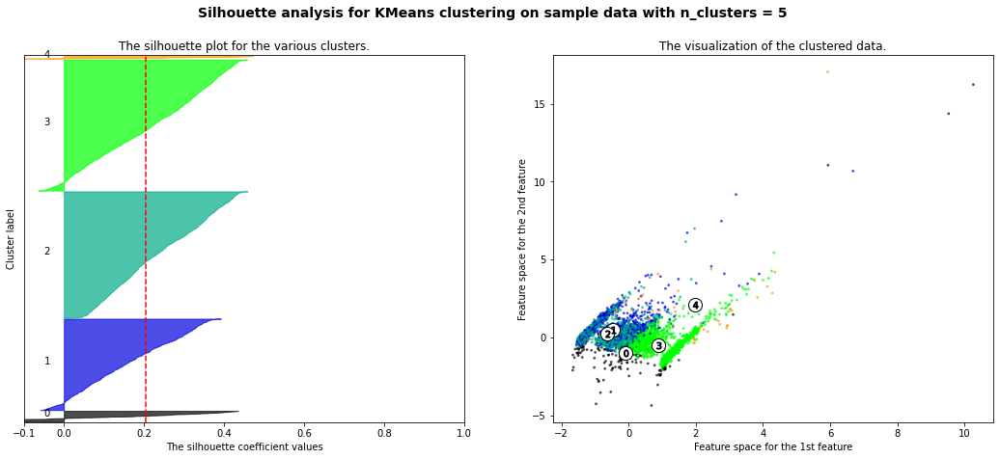

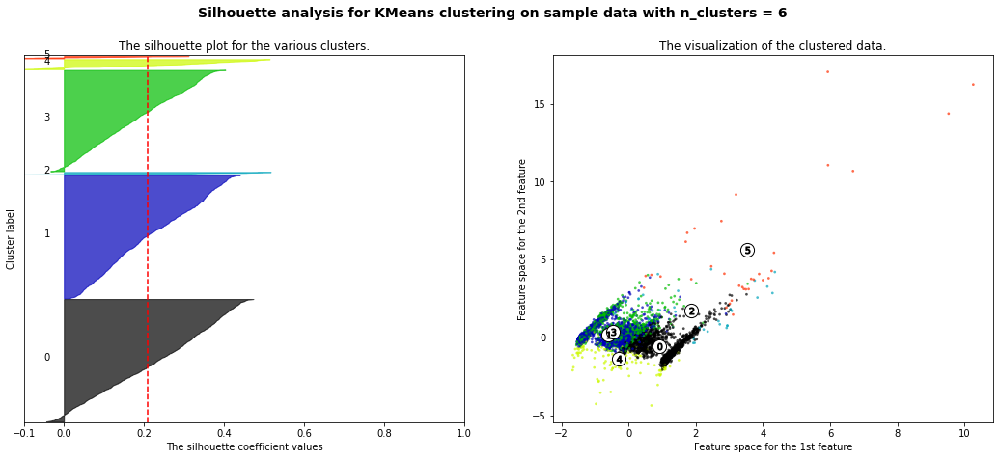

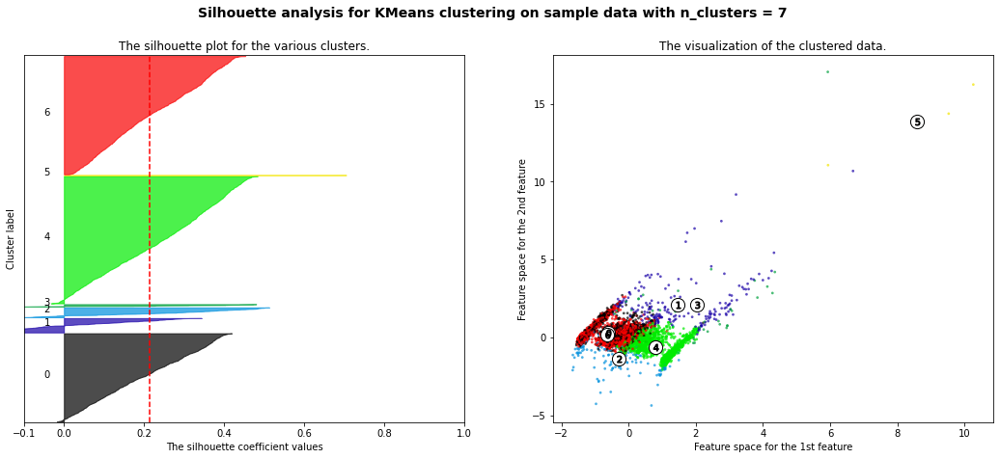

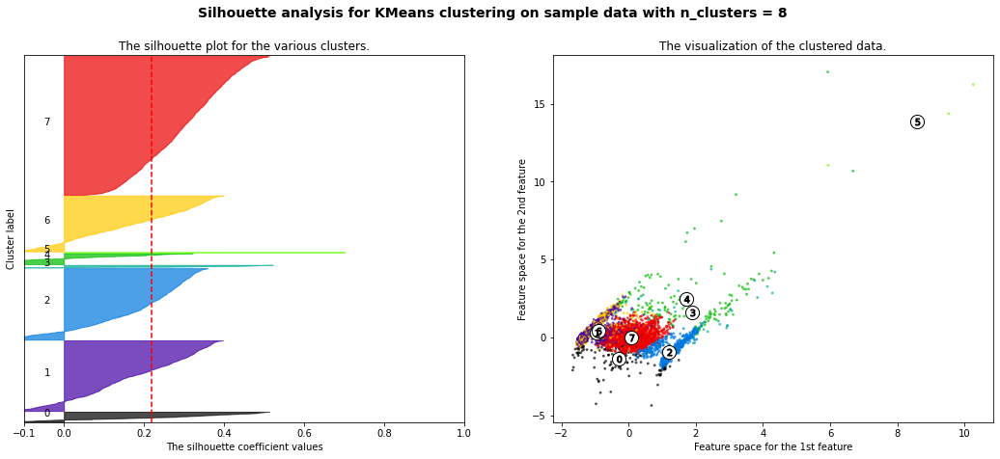

In [ ]:
# YOUR CODE HERE

6. Instantiate a k-means model using the number of cluster that you deem optimal, assign it to `km`, and fit on the reduced data. 

In [ ]:
# YOUR CODE HERE

KMeans(n_clusters=4, random_state=10)

7. What is the size of each cluster? 

In [ ]:
# YOUR CODE HERE

8. Create a new column called `cluster_pca` in `past`, with values as predicted cluster index predicted by `km`. 

In [ ]:
# YOUR CODE HERE

9. Open ended: manipulate `past` and see if you can characterize each cluster (e.g., calculate statistics of / visualize features for each cluster), how will you intepret the results? 

    **Note**. This is probably the most important part as far as the business stakeholders are concerned: "*What can I do with your results?*" The math, modeling part is relatively easy, compared to actionable recommendations you make for business. Thus, before jumping on a different algorithm for the given task, do you best to 1) understand the data in depth 2) keep buisiness use cases in mind throughout all steps. 

    *YOUR ANSWER HERE*

In [ ]:
# YOUR CODE HERE

10. What are the assumptions for k-means? Judging by the cluster sizes, is k-means a good approach? 

    Scanning the list of [clustering algorithms](https://scikit-learn.org/stable/modules/clustering.html) implemented in scikit-learn, try at least one other algorithm, examine its assumptions, and intepret results.

    *YOUR ANSWER HERE*

In [ ]:
# YOUR CODE HERE

11. Jot down recommendations or followup steps, detailing the reasons.

    *YOUR ANSWER HERE*

## Task 3. To launch or not to launch?

In this task, we will work on a hypothetical application: cosmetics purchase prediction for new products with limited features. The intention here is to maximize **recall** so that no popular cosmetic is understocked. Overstocking is less of a concern since it will not cause disengagement in customers.

The purchase status for each "new" product is known, but we only use the labels for benchmarking purpose. Instead, we use label spreading method to leverage a small amount of labeled data in combination with a larger amount of unlabeled data. 

1. Read in the data in `new.csv.gz` and save it as a `pd.DataFrame` named `new`. This is the test dataset.

    Look at the shape of `new` and inspect the frist few rows.

In [ ]:
# YOUR CODE HERE

In [ ]:
assert new.shape == (30091, 5)

In [ ]:
new.head()

,product_id,maxPrice,minPrice,Purchased?,Category
0,5866502,7.62,7.62,0,1.00
1,5870408,6.27,6.27,0,3.00
2,5900580,10.01,10.01,0,1.00
3,5918778,5.98,5.98,0,2.50
4,5848772,26.83,26.83,0,1.00


2. How does the number of data points in the training set (`past`) compare to the number of datapoints in the test set (`new`)? 

    And how does the feature set in the training set compare to the feature set in the test set?

        *YOUR ANSWER HERE*

    *The number of datapoints in the training set is relatively small while the test set is quite large. The training set has more features than in the test set.*

3. Are there any product ids in both the training and test datasets? Hint: use `np.intersect1d` or set operations.

4. What percentage of data points resulted in a purchase in the test set?

    In reality, we won't be able to calculate information that is not available to you. Here, we simply demonstrated that the distributions in target between `past` and `new` are similar. 

In [ ]:
# YOUR CODE HERE # ~.344

5. Create `ndarray`s: `X_train`, `y_train`, `X_test`, and `y_test` according to the following guidelines.

    - The `Purchased?` column is the target.
    - `X_train` and `X_test` should contain the same features
    - `product_id` should not be a feature.

    Double check that the shapes of the four arrays are what you expect.

In [ ]:
# YOUR CODE HERE

In [ ]:
assert X_train.shape[0] == y_train.shape[0] # 5000
assert X_train.shape[1] == X_test.shape[1]  # 3

assert type(X_train) == np.ndarray # make sure you import numpy as np at this point
assert type(X_train).__module__ == type(y_train).__module__ == np.__name__  # alternative way

6. Let's fit a simple logistic regression on the training set (`X_train`, `y_train`) and report performance on the test set (`X_test`, `y_test`).

In [ ]:
# YOUR CODE HERE

              precision    recall  f1-score   support

           0       0.78      0.94      0.85     19732
           1       0.81      0.49      0.61     10359

    accuracy                           0.79     30091
   macro avg       0.80      0.72      0.73     30091
weighted avg       0.79      0.79      0.77     30091



7. Re-assemble data for semi-supervised learning. 
    - Use the features from the test set along with the features from the training set. 
    - Only use the labels from the training set but none from the test set.  
    
    Since we're using a large number of sampled features, but only a small number of these samples have labels, this is **semi-supervised learning**.

Create a matrix `X` that has the rows from `X_train` concatenated with the rows from `X_test`. Check the shape of the matrix.

In [ ]:
# YOUR CODE HERE

In [ ]:
assert X.shape == (35091, 3)

Create the target array `y` by concatenating `y_train` with a vector of -1's, effectively creating a dummy label for the `X_test` rows in `X`. Check the shape of the array. It should have as many values as `X` has rows.

In [ ]:
# YOUR CODE HERE

In [ ]:
assert X.shape[0] == y.shape[0]

8. Semi-supervised learning. 

    Scikit-learn provides two label propagation models: [`LabelPropagation`](https://scikit-learn.org/stable/modules/generated/sklearn.semi_supervised.LabelPropagation.html) and [`LabelSpreading`](https://scikit-learn.org/stable/modules/generated/sklearn.semi_supervised.LabelSpreading.html). Both work by constructing a similarity graph over all items in the input dataset. `LabelSpreading` is similar to the basic Label Propagation algorithm, but it uses an affinity matrix based on the normalized graph Laplacian and soft clamping across the labels; thus more robust to noise. We will be using scikit-learn's `LabelSpreading` model with `kNN`.
    
    Train a `LabelSpreading` model. Set `kernel` to `knn` and `alpha` to 0.01.

In [ ]:
# YOUR CODE HERE

LabelSpreading(alpha=0.01, kernel='knn')

9. Extract the predictions for the test data. 

    You can get the predictions from the `transduction_` attribute. Note that there is a value for every row in `X`, so select just the values that correspond to `X_test`.

In [ ]:
semi_sup_preds = # YOUR CODE HERE

In [ ]:
assert semi_sup_preds.shape[0] == X_test.shape[0]

10. Print the classification report

In [ ]:
print(classification_report(y_test, semi_sup_preds)) # make sure you properly import classification_report

              precision    recall  f1-score   support

           0       0.83      0.93      0.87     19732
           1       0.83      0.62      0.71     10359

    accuracy                           0.83     30091
   macro avg       0.83      0.78      0.79     30091
weighted avg       0.83      0.83      0.82     30091



Let's bring the performance from the supervised learning model down to see the comparison; discuss the areas of improvement and reasons for improvement.

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.78      0.94      0.85     19732
           1       0.81      0.49      0.61     10359

    accuracy                           0.79     30091
   macro avg       0.80      0.72      0.73     30091
weighted avg       0.79      0.79      0.77     30091



    *YOUR ANSWER HERE*

11. Read [Small Data Can Play a Big Role in AI](https://hbr.org/2020/02/small-data-can-play-a-big-role-in-ai) and discuss with your teammate about AI tools for training AI with small data and their use cases. 

## Acknowledgement & References

- data was adapted from Kaggle: [eCommerce Events History in Cosmetics Shop](https://www.kaggle.com/mkechinov/ecommerce-events-history-in-cosmetics-shop)
- function `visualize_silhouette` was adapted from [plot_kmeans_silhouette_analysis by scikit-learn](https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html)
- [Categorizing Online Shopping Behavior from Cosmetics to Electronics: An Analytical Framework](https://arxiv.org/pdf/2010.02503.pdf)
- [OPAM: Online Purchasing-behavior Analysis using Machine learning](https://arxiv.org/pdf/2102.01625.pdf)